In [ ]:
%load_ext autoreload
%autoreload 2
import matplotlib
import matplotlib.ticker as ticker
import modelling as mdl
from sklearn.linear_model import *
from sklearn.neural_network import *
from sklearn.ensemble import *
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_percentage_error as mape
from importlib import reload
import keras
import getpass
from telecontrol_parser import egv_standard_run


In [ ]:
if False:
    folder = fr"C:\Users\{getpass.getuser()}\OneDrive - Hoogheemraadschap van Delfland\3_Projecten\Zoutindringing\Data\features\egv_feats"
    for location in ['parkhaven', 'schiegemaal', 'westland', 'zaayer']:

        egv_standard_run(location).to_parquet(f"{folder}/{location}_feats.parquet")

In [ ]:

print("input moet waarschijnlijk 631 features zijn")

MLdb = mdl.MLdata(fr'C:\Users\{getpass.getuser()}\OneDrive - Hoogheemraadschap van Delfland\3_Projecten\Zoutindringing\Data\features\\')
MLdb.load_datasets()
print()
MLdb.set_dataset(2,features=('egv_feats', 'lobith_feats','gemaal_feats','knmi_feats','waterstanden_feats'))
# MLdb.set_dataset(2,features=tuple())



1: feats_parkhaven.parquet
2: feats_schiegemaal.parquet
3: feats_westland.parquet
4: feats_zaayer.parquet


5: parkhaven_feats.parquet
6: schiegemaal_feats.parquet
7: westland_feats.parquet
8: zaayer_feats.parquet
9: gemaal_feats.parquet
10: knmi_feats.parquet
11: lobith_feats.parquet
12: waterstanden_feats.parquet
Loading egv_feats


In [ ]:

# MLdb.combine_datasets()
# print(MLdb.datadict[list(MLdb.datadict.keys())[2]])
# print(MLdb.datadict['ALL'])
# print(MLdb.get_datasets())
print(len(MLdb.dataset.columns))
MLdb.clean_columns()
print(len(MLdb.dataset.columns))
MLdb.drop_na()
print(len(MLdb.dataset.columns))
MLdb.create_train_test_split(0.8)

# MLdb.linear_regression()
MLdb.scale_data(mode = 'y',scaler = 'minmax')
y_pred_naive = MLdb.naive_predictive()
# MLdb.dataset
# MLdb.vif_threshold = 20

AttributeError: 'MLdata' object has no attribute 'dataset'

In [ ]:
# reshape input to be [samples, time steps, features]
# trainX = np.reshape(np.array(MLdb.train_x), (MLdb.train_x.shape[0], 1, MLdb.train_x.shape[1]))
# testX = np.reshape(np.array(MLdb.test_x), (MLdb.test_x.shape[0], 1, MLdb.test_x.shape[1]))


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import math

<AxesSubplot:>

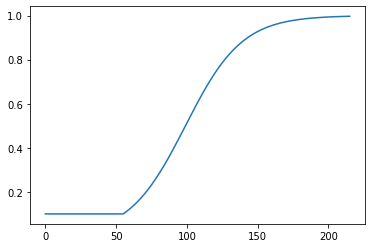

In [ ]:
bereik = MLdb.train_y.shape[1]+1
xrange = (list(range(1,bereik)))
exp = 8
offset = 6*2
k = 0.05
# weights = list(map(lambda x : min(1.0,max(0.1,(x+offset)**exp/(bereik-1)**exp)),xrange))
weights = list(map(lambda x : max(0.1,(bereik/(1+(math.e**(-k*(x-100))))/bereik)),xrange))
pd.Series(weights).plot()

In [ ]:


path_checkpoint = "model_checkpoint.h5"
es_callback = keras.callbacks.EarlyStopping(monitor="val_loss", min_delta=0, patience=3)

modelckpt_callback = keras.callbacks.ModelCheckpoint(
    monitor="val_loss",
    filepath=path_checkpoint,
    verbose=1,
    save_weights_only=True,
    save_best_only=True,
)

In [ ]:
modelckpt_callback.model

In [ ]:
dir(modelckpt_callback)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_batches_seen_since_last_saving',
 '_checkpoint_exists',
 '_chief_worker_only',
 '_get_file_path',
 '_get_most_recently_modified_file_matching_pattern',
 '_implements_predict_batch_hooks',
 '_implements_test_batch_hooks',
 '_implements_train_batch_hooks',
 '_keras_api_names',
 '_keras_api_names_v1',
 '_last_batch_seen',
 '_maybe_remove_file',
 '_options',
 '_save_model',
 '_should_save_on_batch',
 '_supports_tf_logs',
 'best',
 'epochs_since_last_save',
 'filepath',
 'load_weights_on_restart',
 'model',
 'monitor',
 'monitor_op',
 'on_batch_begin',
 'on_batch_end',
 'on_epoch_begin',
 'on_epoch_end',
 'on_predict_batch_b

In [ ]:
look_back = 1
trainY = np.array(MLdb.train_y)
# create and fit the LSTM network
model = Sequential()
model.add(Dense(MLdb.train_x.shape[1],input_shape=(MLdb.train_x.shape[1],)))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))

model.add(Dense(216))
model.compile(loss=tensorflow.keras.losses.MeanSquaredError(), 
    optimizer=tensorflow.keras.optimizers.Adam(
        learning_rate= 0.0001),
    loss_weights = weights
    )
# model.build(input_shape = (1,1,12))
model.summary()
history = model.fit(MLdb.train_x, MLdb.train_y_scaled, 
    epochs=20, 
    batch_size=64, 
    verbose=2,
    # validation_data=(MLdb.test_x,np.array(MLdb.test_y_scaled)),
    callbacks=[es_callback, modelckpt_callback]
    )
def visualize_loss(history, title):
    loss = history.history["loss"]
    # val_loss = history.history["val_loss"]
    epochs = range(len(loss))
    plt.figure()
    plt.plot(epochs, loss, "b", label="Training loss")
    # plt.plot(epochs, val_loss, "r", label="Validation loss")
    plt.title(title)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

visualize_loss(history, "Training and Validation Loss")

In [ ]:
y_pred_train = pd.DataFrame(model.predict(MLdb.train_x))
y_pred = pd.DataFrame(model.predict(MLdb.test_x))

In [ ]:
y_pred_unscaled =  pd.DataFrame(MLdb.scaler_y.inverse_transform(y_pred))
y_pred_train_unscaled =  pd.DataFrame(MLdb.scaler_y.inverse_transform(y_pred_train))

<Figure size 432x288 with 0 Axes>

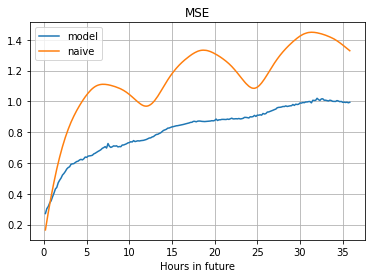

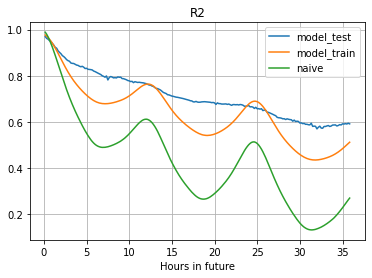

<Figure size 432x288 with 0 Axes>

In [ ]:
mape_list = []
R2_list = []
R2_train_list = []
mape_list_naive = []
R2_list_naive = []

# y_pred_train = model.predict(MLdb.train_x)
# y_pred_train = pd.DataFrame(model.predict(np.reshape(np.array(MLdb.train_x),(MLdb.train_x.shape[0],1,MLdb.train_x.shape[1]))))
# y_pred_train = pd.DataFrame(MLdb.scaler.inverse_transform(pd.DataFrame(model.predict(train_data_gen))))


for i in range(0,MLdb.test_y.shape[1]-1):
    # test_y = MLdb.test_y.iloc[:,i].values
    # train_y = MLdb.train_y.iloc[:,i].values
    # pred_y = y_pred.iloc[:,i]
    # pred_y_train = y_pred_train.iloc[:,1]
    # pred_y_naive = y_pred_naive.iloc[:,i]
    test_y = MLdb.test_y.iloc[:,i].values
    train_y = MLdb.train_y.iloc[:,i].values
    pred_y = y_pred_unscaled.iloc[:,i]
    pred_y_train = y_pred_train_unscaled.iloc[:,1]
    pred_y_naive = y_pred_naive.iloc[:,i]
    
    mape_list.append(mse(test_y,pred_y)**(1/2))
    R2_list.append(r2_score(test_y,pred_y))
    mape_list_naive.append(mse(test_y,pred_y_naive)**(1/2))
    R2_list_naive.append(r2_score(test_y,pred_y_naive))
    R2_train_list.append(r2_score(train_y,pred_y_train))

R2_list = np.array(R2_list).clip(min=0)


x_bereik = [(i*10+10)/60 for i in range(len(R2_list))]
plt.plot(x_bereik,mape_list,label = 'model')
plt.plot(x_bereik,mape_list_naive,label = 'naive')
plt.title('MSE')
plt.xlabel('Hours in future')
plt.legend()
plt.grid()
plt.figure()
plt.plot(x_bereik,R2_list,label = 'model_test')
plt.plot(x_bereik,R2_train_list,label ='model_train')
plt.plot(x_bereik,R2_list_naive, label = 'naive')
plt.title('R2')
plt.xlabel('Hours in future')
plt.legend()
plt.grid()
plt.figure()


In [ ]:
model.save('NN.h5')
MLdb.model = model
MLdb.create_predictions()


In [ ]:
model = keras.models.load_model('NN.h5')
model.history

In [ ]:
model = keras.models.load_model(r'model_checkpoint.h5')
model.history

ValueError: No model config found in the file at <tensorflow.python.platform.gfile.GFile object at 0x000002DF8587A1C0>.

In [ ]:
print(model.history)

None


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 631)               398792    
                                                                 
 dense_1 (Dense)             (None, 631)               398792    
                                                                 
 dense_2 (Dense)             (None, 631)               398792    
                                                                 
 dense_3 (Dense)             (None, 631)               398792    
                                                                 
 dense_4 (Dense)             (None, 631)               398792    
                                                                 
 dense_5 (Dense)             (None, 631)               398792    
                                                                 
 dense_6 (Dense)             (None, 631)               3

In [ ]:
model._feed_input_shapes

[(None, 631)]

In [ ]:
model.weights[0].shape

TensorShape([631, 631])

In [ ]:
dir(model)

['_SCALAR_UPRANKING_ON',
 '_TF_MODULE_IGNORED_PROPERTIES',
 '__call__',
 '__class__',
 '__copy__',
 '__deepcopy__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_activity_regularizer',
 '_add_trackable',
 '_add_trackable_child',
 '_add_variable_with_custom_getter',
 '_assert_compile_was_called',
 '_assert_weights_created',
 '_auto_track_sub_layers',
 '_autocast',
 '_autographed_call',
 '_base_model_initialized',
 '_build_graph_network_for_inferred_shape',
 '_build_input_shape',
 '_call_spec',
 '_callable_losses',
 '_captured_weight_regularizer',
 '_cast_single_input',
 '_check_call_args',
 '_check_sample_weight_warning',
 '_checkpoint',
 '_check

In [ ]:
model.load_weights('./checkpoints/my_checkpoint')

MLdb.model = model
MLdb.create_predictions()

In [ ]:
MLdb.predict_window2(MLdb.get_random_date())

,EGV_OPP,ypred
datetime,,
2021-10-27 06:30:00,1.917,NaN
2021-10-27 06:40:00,1.855,NaN
2021-10-27 06:50:00,1.744,NaN
2021-10-27 07:00:00,1.832,NaN
2021-10-27 07:10:00,1.841,NaN
...,...,...
2021-10-30 17:50:00,3.408,3.603519
2021-10-30 18:00:00,3.899,3.655334
2021-10-30 18:10:00,4.073,3.684157


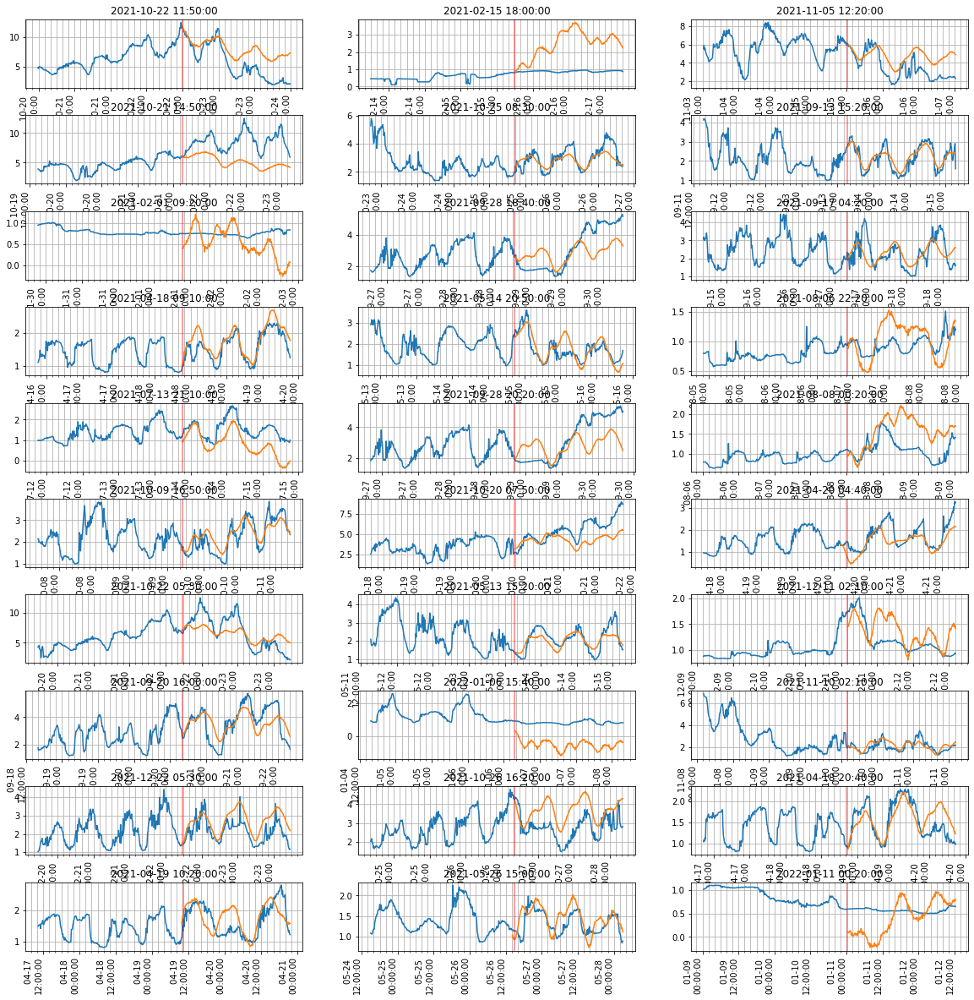

In [ ]:
rows = 10
cols = 3
yscale = 1
xscale = 2

fig, ax = plt.subplots(nrows=rows, ncols=cols)

for row in range(rows):
    for col in range(cols):
        startdate = MLdb.get_random_date('test')
        comp = MLdb.predict_window2(past = 2,startdate = startdate)
        plot = comp.plot(ax = ax[row,col], legend = False,x_compat = True)

        plot.set(xlabel=None)
        # plot.xaxis.get_ticklocs(minor=True)
        plot.set_title(str(startdate))
        # plot.minorticks_on()
        plot.xaxis.set_minor_locator(ticker.AutoMinorLocator(6))
        plot.xaxis.set_major_formatter(matplotlib.dates.DateFormatter('%m-%d \n%H:%M:%S'))


        plot.tick_params(axis='x',labelsize = 10,labelrotation= 90)
        plot.grid(which = 'both')
        plot.axvline(startdate,color = 'red',alpha = 0.5)

plt.subplots_adjust(hspace=0.4)
plt.show()


2022-01-01 18:50:00
2022-01-01 19:00:00
2022-01-01 19:10:00
2022-01-01 19:20:00
2022-01-01 19:30:00
2022-01-01 19:40:00
2022-01-01 19:50:00
2022-01-01 20:00:00
2022-01-01 20:10:00
2022-01-01 20:20:00
2022-01-01 20:30:00
2022-01-01 20:40:00
2022-01-01 20:50:00
2022-01-01 21:00:00
2022-01-01 21:10:00
2022-01-01 21:20:00
2022-01-01 21:30:00
2022-01-01 21:40:00
2022-01-01 21:50:00
2022-01-01 22:00:00
2022-01-01 22:10:00
2022-01-01 22:20:00
2022-01-01 22:30:00
2022-01-01 22:40:00
2022-01-01 22:50:00
2022-01-01 23:00:00
2022-01-01 23:10:00
2022-01-01 23:20:00
2022-01-01 23:30:00
2022-01-01 23:40:00
2022-01-01 23:50:00
2022-01-02 00:00:00
2022-01-02 00:10:00
2022-01-02 00:20:00
2022-01-02 00:30:00
2022-01-02 00:40:00
2022-01-02 00:50:00
2022-01-02 01:00:00
2022-01-02 01:10:00
2022-01-02 01:20:00
2022-01-02 01:30:00
2022-01-02 01:40:00
2022-01-02 01:50:00
2022-01-02 02:00:00
2022-01-02 02:10:00
2022-01-02 02:20:00
2022-01-02 02:30:00
2022-01-02 02:40:00
2022-01-02 02:50:00
2022-01-02 03:00:00


<AxesSubplot:xlabel='datetime'>

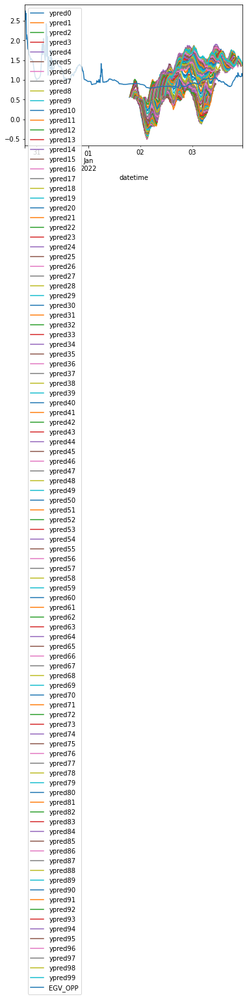

In [ ]:
MLdb.simulate_live(100).plot()

In [ ]:
import shap

c:\Users\Admin\Anaconda3\envs\py36_env\lib\site-packages\tqdm\auto.py:22: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



In [ ]:
explainer = shap.KernelExplainer(MLdb.model, shap.sample(MLdb.train_x,1000))

Using 1000 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [ ]:
X_idx = 0
shap_values = explainer.shap_values(X = MLdb.train_x.iloc[X_idx:X_idx+10,:],nsamples=100)

# X_train = MLdb.train_x
# background = X_train.iloc[np.random.choice(X_train.shape[0], 100, replace=False)]

# explainer = shap.DeepExplainer(
#     (model.layers[0].input, model.layers[-1].output), background
# )

  0%|          | 0/10 [00:00<?, ?it/s]Regressors in active set degenerate. Dropping a regressor, after 39 iterations, i.e. alpha=1.833e-03, with an active set of 17 regressors, and the smallest cholesky pivot element being 1.054e-08. Reduce max_iter or increase eps parameters.
Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 151 iterations, alpha=7.147e-04, previous alpha=7.147e-04, with an active set of 28 regressors.
Regressors in active set degenerate. Dropping a regressor, after 9 iterations, i.e. alpha=3.749e-03, with an active set of 9 regressors, and the smallest cholesky pivot element being 2.107e-08. Reduce max_iter or increase eps parameters.
Regressors in active set degenerate. Dropping a regressor, after 134 iterations, i.e. alpha=8.498e-04, with an active set of 28 regressors, and the smallest cholesky pivot element being 1.825e-08. Reduce max_iter or increase eps parameters.
Regressors in active set degen

In [ ]:
shap_values[0].shape

(10, 631)

In [ ]:
# shap.summary_plot(shap_values,MLdb.train_x,feature_names=MLdb.train_x.columns)

In [ ]:
shap.initjs()
i= 200
shap.force_plot(explainer.expected_value[i], shap_values[i],feature_names=MLdb.train_x.columns)


Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 


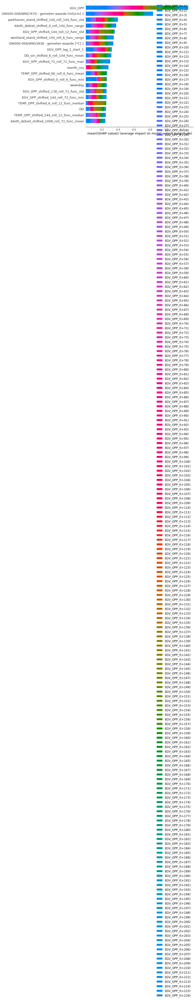

In [ ]:
shap.summary_plot(shap_values,MLdb.train_x,feature_names = MLdb.train_x.columns,class_names=MLdb.train_y.columns,class_inds=list(range(216)))

In [ ]:
# shap.waterfall_plot(explainer.expected_value,shap_values)

In [ ]:
shap.plots.force(0,np.array([i.flatten() for i in shap_values]),feature_names=MLdb.train_y.columns)

In [ ]:
for ele in range(10):
   if ele==9:
    shap.plots.force(0,np.array([i[ele] for i in shap_values]),feature_names=MLdb.train_y.columns)


In [ ]:
np.array([i[5] for i in shap_values]).shape

(216, 631)

In [ ]:
shap.save_html('SHAPLEY2.html',shap.plots.force(explainer.expected_value[0],np.array([i[0] for i in shap_values]),feature_names=MLdb.train_x.columns,figsize=(20, 9)))

In [ ]:
shap.plots.force(explainer.expected_value[0],np.array([i[9] for i in shap_values]),feature_names=MLdb.train_x.columns,figsize=(20, 9))

In [ ]:
explainer.expected_value[0]

0.15352986958995463

In [ ]:
comp = MLdb.predict_window2(startdate = MLdb.train_x.index[9])
plot = comp.plot(ax = ax[row,col], legend = False,x_compat = True)

plot.set(xlabel=None)
# plot.xaxis.get_ticklocs(minor=True)
plot.set_title(str(startdate))
# plot.minorticks_on()
plot.xaxis.set_minor_locator(ticker.AutoMinorLocator(6))
plot.xaxis.set_major_formatter(matplotlib.dates.DateFormatter('%m-%d \n%H:%M:%S'))


plot.tick_params(axis='x',labelsize = 10,labelrotation= 90)
plot.grid(which = 'both')
plot.axvline(startdate,color = 'red',alpha = 0.5)
plt.show()

<AxesSubplot:>

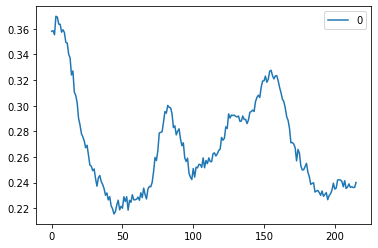

In [ ]:
pd.DataFrame(MLdb.scaler_y.transform(pd.DataFrame(comp['ypred'].T[1:]).T)[0]).plot()